In [107]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import math
import plotly.express as px
import seaborn as sns
from sklearn.linear_model import LinearRegression
from stargazer.stargazer import Stargazer
import statsmodels.api as sm
import statsmodels.formula.api as smf
from pymer4.models import Lmer

## List / Hist / Scatter

In [2]:
edx = pd.read_csv("HXPC13_DI_v3_11-13-2019.csv")
edx.head(10)

,course_id,userid_DI,registered,viewed,explored,certified,final_cc_cname_DI,LoE_DI,YoB,gender,grade,start_time_DI,last_event_DI,nevents,ndays_act,nplay_video,nchapters,nforum_posts,roles,incomplete_flag
0,HarvardX/CB22x/2013_Spring,MHxPC130442623,1,0,0,0,United States,NaN,NaN,NaN,0,12/19/12,11/17/13,NaN,9.0,NaN,NaN,0,NaN,1.0
1,HarvardX/CB22x/2013_Spring,MHxPC130275857,1,0,0,0,United States,NaN,NaN,NaN,0,2/8/13,11/17/13,NaN,16.0,NaN,NaN,0,NaN,1.0
2,HarvardX/CB22x/2013_Spring,MHxPC130539455,1,1,0,0,France,NaN,NaN,NaN,0,1/1/13,5/14/13,42.0,6.0,NaN,3.0,0,NaN,NaN
3,HarvardX/CB22x/2013_Spring,MHxPC130088379,1,1,0,0,United States,NaN,NaN,NaN,0,2/18/13,3/17/13,70.0,3.0,NaN,3.0,0,NaN,NaN
4,HarvardX/CB22x/2013_Spring,MHxPC130024894,1,1,0,0,United States,NaN,NaN,NaN,0.07,1/24/13,8/3/13,175.0,9.0,NaN,7.0,0,NaN,NaN
5,HarvardX/CB22x/2013_Spring,MHxPC130340959,1,1,0,0,United States,NaN,NaN,NaN,0.05,2/11/13,4/6/13,285.0,8.0,NaN,4.0,0,NaN,NaN
6,HarvardX/CB22x/2013_Spring,MHxPC130148402,1,0,0,0,United States,NaN,NaN,NaN,0,12/23/12,11/17/13,NaN,NaN,NaN,NaN,0,NaN,NaN
7,HarvardX/CB22x/2013_Spring,MHxPC130435030,1,1,0,0,Canada,NaN,NaN,NaN,0,2/20/13,6/29/13,80.0,5.0,NaN,2.0,0,NaN,NaN
8,HarvardX/CB22x/2013_Spring,MHxPC130542822,1,1,0,0,United States,NaN,NaN,NaN,NaN,12/20/12,3/14/13,21.0,3.0,NaN,1.0,0,NaN,NaN
9,HarvardX/CB22x/2013_Spring,MHxPC130069044,1,0,0,0,United States,NaN,NaN,NaN,0,4/22/13,4/23/13,1.0,1.0,NaN,NaN,0,NaN,NaN


Text(0.5, 0, 'Number of forum posts per user/course')

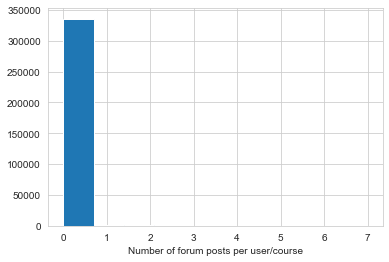

In [123]:
plt.hist(edx["nforum_posts"])
plt.xlabel("Number of forum posts per user/course")

Text(0.5, 0, 'Number of forum posts per user/course')

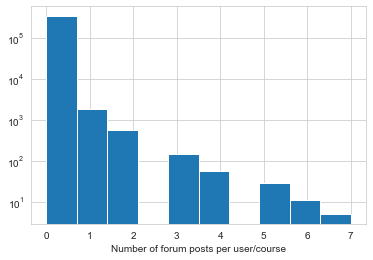

In [126]:
plt.hist(edx['nforum_posts'], log=True, bins=10)
plt.xlabel("Number of forum posts per user/course")

General research question: social interaction behavior relationship with learning

First research question: correlation between forum posts and level of interaction

Relevant factors: nforum_posts, nevents, ndays_act, nplay_video, grade, certified, explored, viewed

Text(0.5, 0, 'Number of events per user/course')

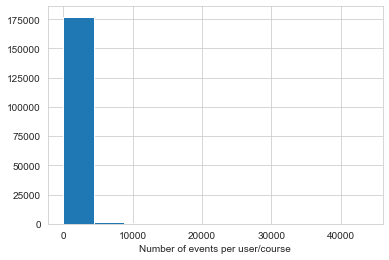

In [130]:
plt.hist(edx["nevents"])
plt.xlabel("Number of events per user/course")

Text(0.5, 0, 'Log of Number of events per user/course + 1')

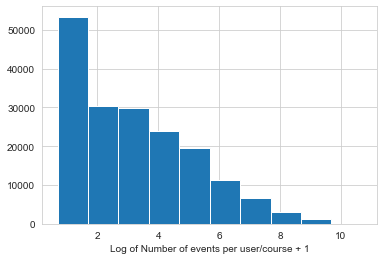

In [129]:
plt.hist(list(math.log(i+1) for i in edx["nevents"]))
plt.xlabel("Log of Number of events per user/course + 1")

(array([1.77132e+05, 1.34800e+03, 3.45000e+02, 9.10000e+01, 1.90000e+01,
        3.00000e+00, 2.00000e+00, 3.00000e+00, 1.00000e+00, 1.00000e+00]),
 array([1.00000e+00, 4.38890e+03, 8.77680e+03, 1.31647e+04, 1.75526e+04,
        2.19405e+04, 2.63284e+04, 3.07163e+04, 3.51042e+04, 3.94921e+04,
        4.38800e+04]),
 <BarContainer object of 10 artists>)

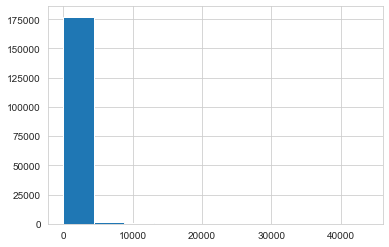

In [127]:
plt.hist(edx["nevents"])

(array([8.7691e+04, 3.3798e+04, 2.8950e+04, 1.7023e+04, 1.2480e+04,
        6.9120e+03, 4.8770e+03, 3.1000e+03, 8.3900e+02, 4.3000e+01]),
 array([0.       , 0.5170484, 1.0340968, 1.5511452, 2.0681936, 2.585242 ,
        3.1022904, 3.6193388, 4.1363872, 4.6534356, 5.170484 ]),
 <BarContainer object of 10 artists>)

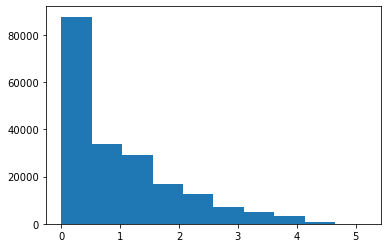

In [6]:
plt.hist(list(math.log(i) for i in edx["ndays_act"]))

(array([5.526e+03, 6.503e+03, 6.367e+03, 5.986e+03, 4.041e+03, 2.595e+03,
        1.618e+03, 5.620e+02, 7.500e+01, 4.000e+00]),
 array([ 0.        ,  1.04514933,  2.09029867,  3.135448  ,  4.18059734,
         5.22574667,  6.27089601,  7.31604534,  8.36119468,  9.40634401,
        10.45149335]),
 <BarContainer object of 10 artists>)

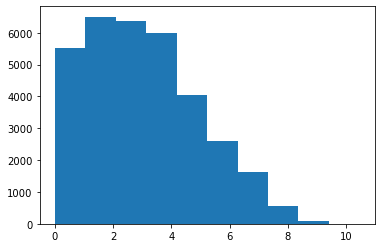

In [7]:
plt.hist(list(math.log(i) for i in edx["nplay_video"]))

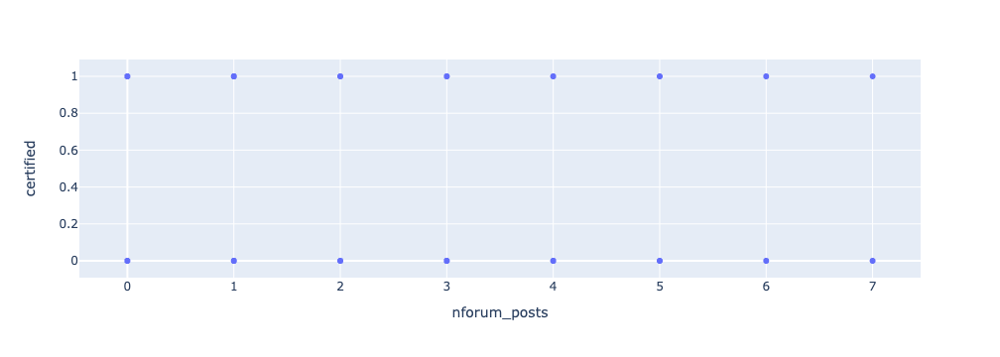

<AxesSubplot:xlabel='nforum_posts', ylabel='certified'>

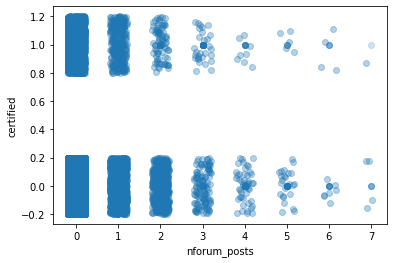

In [14]:
fig = px.scatter(
    edx, x='nforum_posts', y='certified'
)
fig.show()

plt.scatter(data=edx,  x='nforum_posts', y='certified', alpha=1/5)

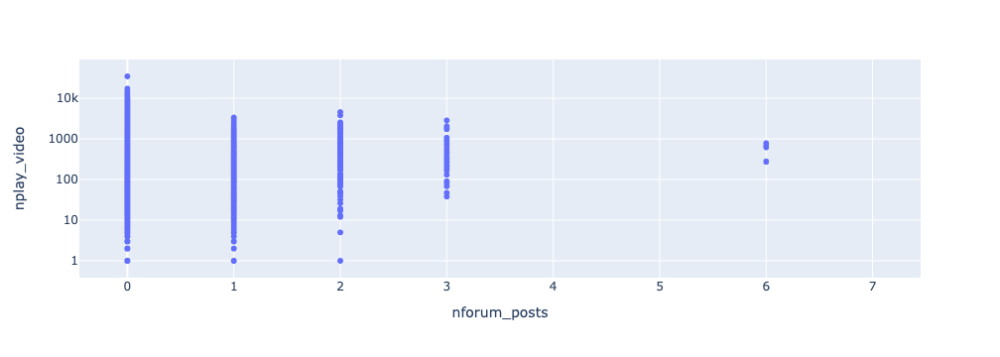

In [9]:
fig = px.scatter(
    edx, y='nplay_video', x='nforum_posts', log_y=True
)
fig.show()

In [94]:
df_countries = edx['final_cc_cname_DI'].value_counts(ascending=False).reset_index()
print(df_countries)

                                     index  final_cc_cname_DI
0                            United States             100152
1                            Unknown/Other              70208
2                                    India              30635
3                             Other Europe              19293
4                             Other Africa              12631
5                           United Kingdom              11562
6                                   Brazil               8491
7                                   Canada               7776
8           Other Middle East/Central Asia               7087
9                         Other South Asia               6666
10                                 Nigeria               4610
11                                   Spain               4465
12                                Pakistan               4066
13                     Other South America               3921
14                                 Germany               3763
15      

## Logistic Regression Analysis

In [98]:
# New column indicating if country is US
edx['isUS'] = np.where(edx['final_cc_cname_DI']== 'United States', 1, 0)

print(edx)

                          course_id       userid_DI  registered  viewed  \
0        HarvardX/CB22x/2013_Spring  MHxPC130442623           1       0   
1        HarvardX/CB22x/2013_Spring  MHxPC130275857           1       0   
2        HarvardX/CB22x/2013_Spring  MHxPC130539455           1       1   
3        HarvardX/CB22x/2013_Spring  MHxPC130088379           1       1   
4        HarvardX/CB22x/2013_Spring  MHxPC130024894           1       1   
...                             ...             ...         ...     ...   
338218  HarvardX/PH278x/2013_Spring  MHxPC130087143           1       0   
338219  HarvardX/PH278x/2013_Spring  MHxPC130430900           1       1   
338220  HarvardX/PH278x/2013_Spring  MHxPC130004339           1       0   
338221  HarvardX/PH278x/2013_Spring  MHxPC130388295           1       0   
338222  HarvardX/PH278x/2013_Spring  MHxPC130490962           1       0   

        explored  certified    final_cc_cname_DI      LoE_DI     YoB gender  \
0              0    

<AxesSubplot:xlabel='nevents', ylabel='nplay_video'>

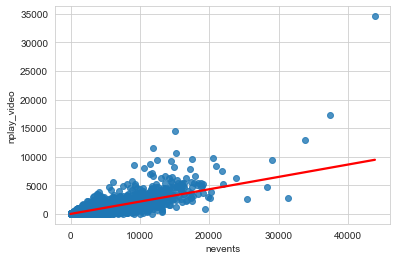

In [75]:
sns.regplot(x=edx["nevents"], y=edx["nplay_video"], ci=None, line_kws={"color": "red"})


Second research question: correlation between numbers of courses taken and participation

Third research question: relationship between forum posts and chapters varies across classes

Logistic regression on dichotomous output with discrete predictor

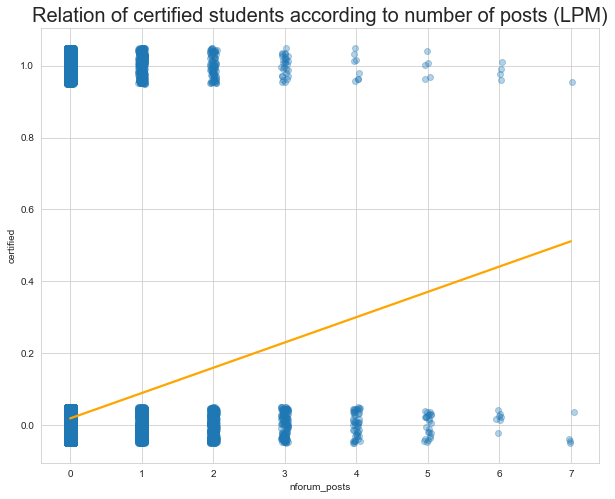

In [100]:
plt.figure(figsize = (10,8))
sns.set_style('whitegrid')
sns.regplot(data = edx, x='nforum_posts', y='certified',
           x_jitter = 0.05, y_jitter = 0.05, scatter_kws = {'alpha' : 1/3}, ci = None, line_kws = {'color': 'orange'})
plt.title('Relation of certified students according to number of posts (LPM)', fontsize = 20)
plt.show()

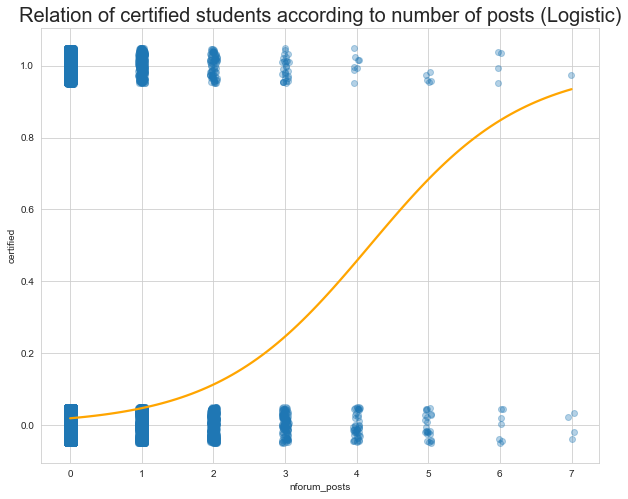

In [39]:
plt.figure(figsize = (10,8))
sns.set_style('whitegrid')
sns.regplot(data = edx, x='nforum_posts', y='certified',
           x_jitter = 0.05, y_jitter = 0.05, scatter_kws = {'alpha' : 1/3}, ci = None, line_kws = {'color': 'orange'}, logistic=True)
plt.title('Relation of certified students according to number of posts (Logistic)', fontsize = 20)
plt.show()

We could use n_events as an indicator of learning instead of certification. Apparently having more posts doesn't mean interacting more with the course.

<AxesSubplot:xlabel='nforum_posts', ylabel='nevents'>

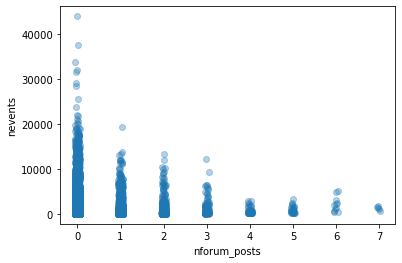

In [19]:
sns.regplot(data = edx, x='nforum_posts', y='nevents', fit_reg = False,
           x_jitter = 0.05, y_jitter = 0.05, scatter_kws = {'alpha' : 1/3})

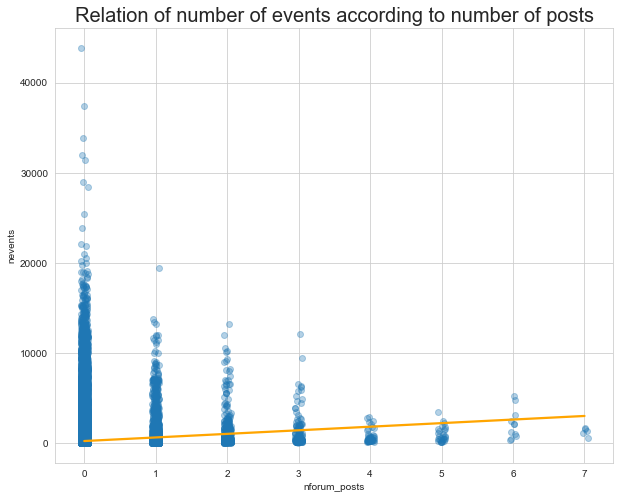

In [34]:
plt.figure(figsize = (10,8))
sns.set_style('whitegrid')
sns.regplot(data = edx, x='nforum_posts', y='nevents',
           x_jitter = 0.05, y_jitter = 0.05, scatter_kws = {'alpha' : 1/3}, ci = None, line_kws = {'color': 'orange'})
plt.title('Relation of number of events according to number of posts', fontsize = 20)
plt.show()

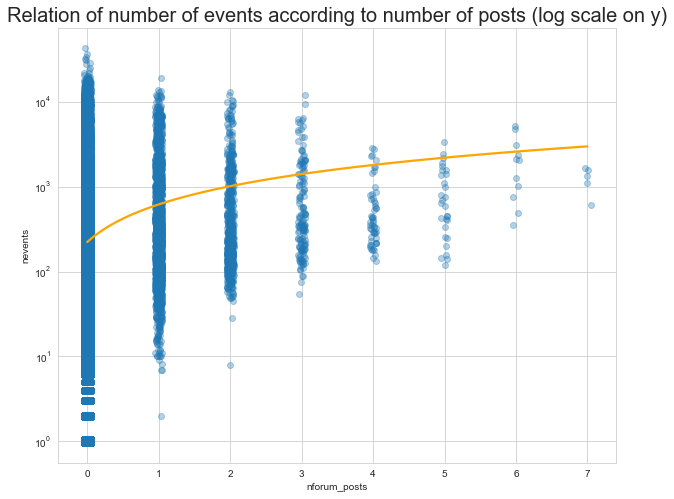

In [102]:
plt.figure(figsize = (10,8))
plt.yscale('log')
sns.set_style('whitegrid')
sns.regplot(data = edx, x='nforum_posts', y='nevents',
           x_jitter = 0.05, y_jitter = 0.05, scatter_kws = {'alpha' : 1/3}, ci = None, line_kws = {'color': 'orange'})
plt.title('Relation of number of events according to number of posts (log scale on y)', fontsize = 20)
plt.show()

Logistic model comparison

In [105]:
edx['ndays_act'] = edx['ndays_act'].fillna(0)

log_model0=smf.logit('certified~1', data=edx).fit()
log_model1=smf.logit('certified~nforum_posts', data=edx).fit()
log_model2=smf.logit('certified~ndays_act', data=edx).fit()
log_model3=smf.logit('certified~nforum_posts+ndays_act', data=edx).fit()
log_model4=smf.logit('certified~nforum_posts+ndays_act+isUS', data=edx).fit()
log_model5=smf.logit('certified~nforum_posts+ndays_act+isUS+nforum_posts*ndays_act', data=edx).fit()

print(log_model0.summary())
print(log_model1.summary())
print(log_model2.summary())
print(log_model3.summary())
print(log_model4.summary())
print(log_model5.summary())

Optimization terminated successfully.
         Current function value: 0.095793
         Iterations 8
Optimization terminated successfully.
         Current function value: 0.094828
         Iterations 8
Optimization terminated successfully.
         Current function value: 0.056203
         Iterations 9
Optimization terminated successfully.
         Current function value: 0.056089
         Iterations 9
Optimization terminated successfully.
         Current function value: 0.055720
         Iterations 9
Optimization terminated successfully.
         Current function value: 0.055717
         Iterations 9
                           Logit Regression Results                           
Dep. Variable:              certified   No. Observations:               338223
Model:                          Logit   Df Residuals:                   338222
Method:                           MLE   Df Model:                            0
Date:                Sun, 18 Dec 2022   Pseudo R-squ.:               1.6

In [132]:
stargazer=Stargazer([log_model0, log_model1, log_model2, log_model3, log_model4, log_model5])
stargazer.custom_columns(['Model 0', 'Model 1', 'Model 2', 'Model 3', 'Model 4', 'Model 5'], [1, 1, 1, 1, 1, 1])
stargazer
#stargazer.render_latex()

ll base: -32399
ll model 1: -32073
ll model 2: -19009
ll model 3: -18970
ll model 4: -18846
ll model 5: -18970

## Random effects analysis

* Level 1: student/course
* Level 2: isUS




In [114]:
model = Lmer('certified ~ nforum_posts + (1+nforum_posts|isUS)', data=edx).fit()
display(model)

/Users/cristianespinoza/miniforge3/lib/python3.9/site-packages/rpy2/robjects/pandas2ri.py:60: UserWarning:

Error while trying to convert the column "LoE_DI". Fall back to string conversion. The error is: Series can only be of one type, or None (and here we have <class 'float'> and <class 'str'>). If happening with a pandas DataFrame the method infer_objects() will normalize data types before conversion.

/Users/cristianespinoza/miniforge3/lib/python3.9/site-packages/rpy2/robjects/pandas2ri.py:60: UserWarning:

Error while trying to convert the column "gender". Fall back to string conversion. The error is: Series can only be of one type, or None (and here we have <class 'float'> and <class 'str'>). If happening with a pandas DataFrame the method infer_objects() will normalize data types before conversion.



Model failed to converge with max|grad| = 0.0253588 (tol = 0.002, component 1) 

Linear mixed model fit by REML [’lmerMod’]
Formula: certified~nforum_posts+(1+nforum_posts|isUS)

Family: gaussian	 Inference: parametric

Number of observations: 338223	 Groups: {'isUS': 2.0}

Log-likelihood: 191091.249 	 AIC: -382170.497

Random effects:

                  Name    Var    Std
isUS       (Intercept)  0.000  0.004
isUS      nforum_posts  0.002  0.039
Residual                0.019  0.138

              IV1           IV2  Corr
isUS  (Intercept)  nforum_posts   1.0

Fixed effects:



,Estimate,2.5_ci,97.5_ci,SE,DF,T-stat,P-val,Sig
(Intercept),0.017,0.011,0.023,0.003,0.970,5.774,0.115,
nforum_posts,0.081,0.027,0.134,0.027,0.971,2.936,0.215,


In [ ]:
* Level 1: student/course
* Level 2: course instance

In [115]:
model = Lmer('certified ~ nforum_posts + (1+nforum_posts|course_id)', data=edx).fit()
display(model)

/Users/cristianespinoza/miniforge3/lib/python3.9/site-packages/rpy2/robjects/pandas2ri.py:60: UserWarning:

Error while trying to convert the column "LoE_DI". Fall back to string conversion. The error is: Series can only be of one type, or None (and here we have <class 'float'> and <class 'str'>). If happening with a pandas DataFrame the method infer_objects() will normalize data types before conversion.

/Users/cristianespinoza/miniforge3/lib/python3.9/site-packages/rpy2/robjects/pandas2ri.py:60: UserWarning:

Error while trying to convert the column "gender". Fall back to string conversion. The error is: Series can only be of one type, or None (and here we have <class 'float'> and <class 'str'>). If happening with a pandas DataFrame the method infer_objects() will normalize data types before conversion.



Linear mixed model fit by REML [’lmerMod’]
Formula: certified~nforum_posts+(1+nforum_posts|course_id)

Family: gaussian	 Inference: parametric

Number of observations: 338223	 Groups: {'course_id': 5.0}

Log-likelihood: 192813.699 	 AIC: -385615.398

Random effects:

                   Name    Var    Std
course_id   (Intercept)  0.000  0.016
course_id  nforum_posts  0.006  0.080
Residual                 0.019  0.137

                   IV1           IV2   Corr
course_id  (Intercept)  nforum_posts -0.487

Fixed effects:



,Estimate,2.5_ci,97.5_ci,SE,DF,T-stat,P-val,Sig
(Intercept),0.024,0.010,0.037,0.007,4.008,3.364,0.028,*
nforum_posts,0.126,0.049,0.203,0.039,3.085,3.213,0.047,*
